In [85]:
from __future__ import print_function
#%matplotlib inline
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
from torch.utils.data import DataLoader, random_split
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torchvision.utils as vutils
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import torch
from torchvision.utils import make_grid
import matplotlib.pyplot as plt

In [86]:
projectName = "PokeGAN"

In [87]:
stats = (0.5, 0.5, 0.5), (0.5, 0.5, 0.5)

In [88]:
fullTransform = tt.Compose([
    tt.Resize(64),
    tt.CenterCrop(64),
    tt.ToTensor(),
    tt.Normalize(*stats),
])

In [89]:
dataDir = "../BackEnd/pokemon/"
dataset = ImageFolder(dataDir, transform=fullTransform)

In [90]:
img,label = dataset[0]
torch.min(img), torch.max(img)

(tensor(-1.), tensor(1.))

In [91]:
dataset.classes = ['real']
print(dataset.classes)

['real']


In [92]:
def show_images(images, nmax=64):
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denorm(images.detach()[:nmax]), nrow=8).permute(1, 2, 0))

def show_batch(dl, nmax=64):
    for images, _ in dl:
        show_images(images, nmax)
        break
        
def denorm(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]
        
def show_example(img, label):
    print(img.shape)
    plt.imshow(denorm(img.permute(1, 2, 0)))

tensor(-1.)
torch.Size([3, 64, 64])


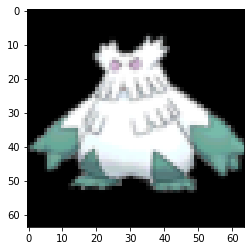

In [93]:
print(torch.min(dataset[0][0]))
show_example(*dataset[0])

torch.Size([3, 64, 64])


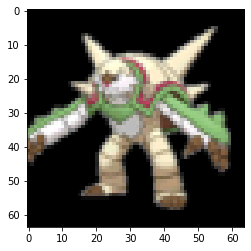

In [94]:
show_example(*dataset[100])

In [95]:
img, label = dataset[0]
img.shape

torch.Size([3, 64, 64])

In [96]:
randomSeed = 99
torch.manual_seed(randomSeed)

In [97]:
def get_default_device():
    """Pick GPU if available, else CPU"""
    if torch.cuda.is_available():
        return torch.device('cuda')
    else:
        return torch.device('cpu')
    
def to_device(data, device):
    """Move tensor(s) to chosen device"""
    if isinstance(data, (list,tuple)):
        return [to_device(x, device) for x in data]
    return data.to(device, non_blocking=True)

class DeviceDataLoader():
    """Wrap a dataloader to move data to a device"""
    def __init__(self, dl, device):
        self.dl = dl
        self.device = device
        
    def __iter__(self):
        """Yield a batch of data after moving it to device"""
        for b in self.dl: 
            yield to_device(b, self.device)

    def __len__(self):
        """Number of batches"""
        return len(self.dl)

In [98]:
numWorkers = 3
batchSize = 64
imageSize = 64
numChannels = 3
latentS = 100
ngf = 64
ndf = 64
numEpochs = 10
lr = .0002
beta1 = .5

In [99]:
device = get_default_device()
device

device(type='cuda')

In [100]:
dataloader = DataLoader(dataset, batch_size = batchSize, shuffle = True, num_workers = numWorkers, pin_memory = True)

In [101]:
dataloader = DeviceDataLoader(dataloader, device)

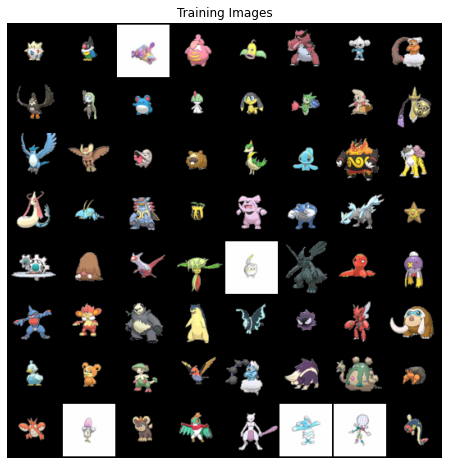

In [102]:
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [103]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [104]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(latentS, 512, 4, 1, 0, bias=False),
            nn.BatchNorm2d(512),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(512, 256, 4, 2, 1, bias=False),
            nn.BatchNorm2d(256),
            nn.ReLU(True),

            nn.ConvTranspose2d( 256, 128, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            nn.ConvTranspose2d( 128, 64, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            
            nn.ConvTranspose2d( 64, 3, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, input):
        return self.main(input)

In [105]:
gen = Generator().to(device)
gen.apply(weights_init)
print(gen)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [106]:
from torch.nn.utils import spectral_norm

In [107]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.main1 = nn.Sequential(
            spectral_norm(nn.Conv2d(numChannels, ndf, 4, 2, 1, bias=False)),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False)),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            spectral_norm(nn.Conv2d(ndf * 8, 16, 4, 1, 0, bias=False)),
            nn.Sigmoid()
        )

        self.main2 = nn.Linear(16, 1, bias=False)
        self.main3 = nn.Sigmoid()

    def forward(self, input, matching=True):
        features = self.main2(self.main1(input).view(-1,16))
        if matching:
          return features, self.main3(features)
        
        return self.main3(features)


In [108]:
dis = Discriminator().to(device)
dis.apply(weights_init)
print(dis)

Discriminator(
  (main1): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 16, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
  (main2): Linear(in_features=

In [109]:
fixed_noise = torch.randn(batchSize, latentS, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

criterion = nn.BCELoss()

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(filter(lambda p: p.requires_grad, dis.parameters()), lr=lr, betas=(0.0,0.9))
optimizerG = optim.Adam(gen.parameters(), lr=lr, betas=(beta1, 0.999))

schedulerD = optim.lr_scheduler.ExponentialLR(optimizerD, gamma=0.99)
schedulerG = optim.lr_scheduler.ExponentialLR(optimizerG, gamma=0.99)

In [110]:
def noisy_labels(labels, prob):
    num = int(prob * labels.shape[0])
    flipped = np.random.choice([i for i in range(labels.shape[0])], size=num)
    
    for i in flipped:
        labels[i] = 1 - labels[i]
    
    return labels

In [111]:
def trainD(real_images, d_optim):
    #reset optimizer
    d_optim.zero_grad()
    
    # Pass real images through discriminator
    real_preds = dis(real_images, matching=False)
    real_targets = torch.randn(real_images.size(0), 1, device=device) * .15 + .85
    real_targets = noisy_labels(real_targets, .05)
    real_loss = criterion(real_preds, real_targets)
    real_score = torch.mean(real_preds).item()
    
    # Generate fake images
    latent = torch.randn(batchSize, latentS, 1, 1, device=device)
    fake_images = gen(latent)

    # Pass fake images through discriminator
    fake_targets = torch.randn(fake_images.size(0), 1, device=device) * .15 + .15
    fake_targets = noisy_labels(fake_targets, .05)
    fake_preds = dis(fake_images, matching=False)
    fake_loss = criterion(fake_preds, fake_targets)
    fake_score = torch.mean(fake_preds).item()

    # Update discriminator weights
    loss = real_loss + fake_loss
    loss.backward()
    d_optim.step()
    return loss.item(), real_score, fake_score

In [112]:
def trainG(g_optim, real_images):
    # Clear generator gradients
    g_optim.zero_grad()
    
    # Generate fake images
    latent = torch.randn(real_images.size(0), latentS, 1, 1, device=device)
    fake_images = gen(latent)
    
    fakeFeatures, preds = dis(fake_images)
    image_pred, _ = dis(real_images)

    fakeFeaturesLoss = torch.mean(fakeFeatures, dim=0)
    imagePredLoss = torch.mean(image_pred, dim=0)

    loss = torch.mean((fakeFeaturesLoss - imagePredLoss) ** 2)
    
    loss.backward()
    g_optim.step()
    
    return loss.item()

In [113]:
from torchvision.utils import save_image

In [114]:
image_dir = 'generated'
os.makedirs(image_dir, exist_ok=True)

generator_dir = 'model/generator/'
discriminator_dir = "model/discriminator/"
os.makedirs(generator_dir, exist_ok=True)
os.makedirs(discriminator_dir, exist_ok=True)

In [115]:
def save_samples(index, fixed_noise, show=True):
    fake_images = gen(fixed_noise)
    fake_fname = 'generated-images-{0:0=4d}.png'.format(index)
    save_image(denorm(fake_images), os.path.join(image_dir, fake_fname), nrow=8)
    print('Saving', fake_fname)
    if show:
        plt.figure()
        fixed_imgs = gen(fixed_noise)
        result = denorm(fixed_imgs.cpu().data)
        result = make_grid(result)
        result = tt.Compose([tt.ToPILImage()])(result)
        plt.imshow(result)
        plt.axis('off')
        plt.show()
    
    if index%5==0:
        generatorFile = generator_dir+"generator-{0:0=4d}.pth".format(index)
        torch.save(gen, generatorFile)
        print("Saving: ", generatorFile)

        discriminatorFile = discriminator_dir+"discriminator-{0:0=4d}.pth".format(index)
        torch.save(dis, discriminatorFile)
        print("Saving: ", discriminatorFile)

Saving generated-images-0000.png


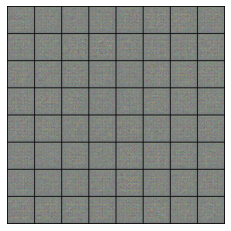

Saving:  model/generator/generator-0000.pth
Saving:  model/discriminator/discriminator-0000.pth


In [116]:
save_samples(0,fixed_noise)

In [117]:
from tqdm.notebook import tqdm

In [118]:
def fit(epochs, lr, start_idx=1):
    torch.cuda.empty_cache()
    
    # Losses & scores
    losses_g = []
    losses_d = []
    real_scores = []
    fake_scores = []
    
    for epoch in range(epochs):
        for real_images, _ in tqdm(dataloader):
            # Train discriminator
            loss_d, real_score, fake_score = trainD(real_images, optimizerD)
            # Train generator
            loss_g = trainG(optimizerG, real_images)
            
        # Record losses & scores
        losses_g.append(loss_g)
        losses_d.append(loss_d)
        real_scores.append(real_score)
        fake_scores.append(fake_score)
        
        # Log losses & scores (last batch)
        print("Epoch [{}/{}], loss_g: {:.4f}, loss_d: {:.4f}, real_score: {:.4f}, fake_score: {:.4f}".format(
            epoch+1, epochs, loss_g, loss_d, real_score, fake_score))
    
        # Save generated images
        save_samples(epoch+start_idx, fixed_noise, show=True)
        schedulerD.step()
        schedulerG.step()
    
    return losses_g, losses_d, real_scores, fake_scores


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [1/2000], loss_g: 4.8549, loss_d: 1.0244, real_score: 0.8172, fake_score: 0.3431
Saving generated-images-0001.png


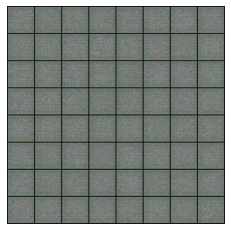

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [2/2000], loss_g: 5.0304, loss_d: 0.9910, real_score: 0.8189, fake_score: 0.3306
Saving generated-images-0002.png


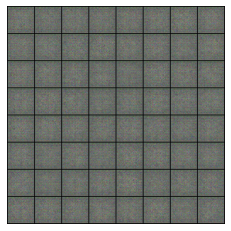

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [3/2000], loss_g: 4.5486, loss_d: 1.0609, real_score: 0.8190, fake_score: 0.3309
Saving generated-images-0003.png


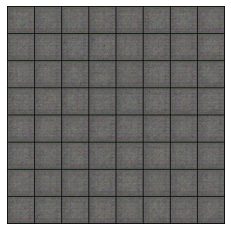

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [4/2000], loss_g: 4.3673, loss_d: 0.9888, real_score: 0.8017, fake_score: 0.3344
Saving generated-images-0004.png


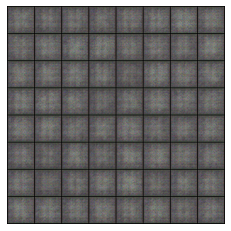

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [5/2000], loss_g: 4.3975, loss_d: 1.0332, real_score: 0.8068, fake_score: 0.3244
Saving generated-images-0005.png


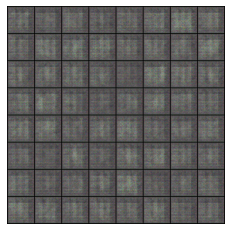

Saving:  model/generator/generator-0005.pth
Saving:  model/discriminator/discriminator-0005.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [6/2000], loss_g: 4.9351, loss_d: 1.0227, real_score: 0.8120, fake_score: 0.3195
Saving generated-images-0006.png


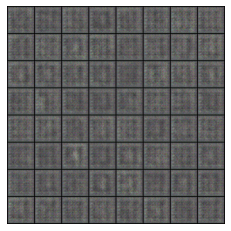

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [7/2000], loss_g: 5.1388, loss_d: 0.9478, real_score: 0.8160, fake_score: 0.3168
Saving generated-images-0007.png


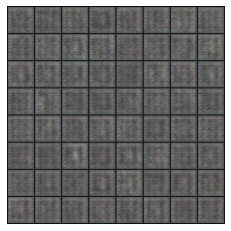

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [8/2000], loss_g: 5.0806, loss_d: 1.0309, real_score: 0.8126, fake_score: 0.3144
Saving generated-images-0008.png


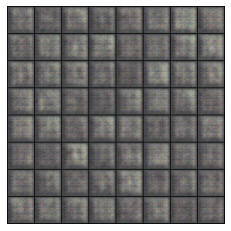

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [9/2000], loss_g: 5.0482, loss_d: 0.9290, real_score: 0.8140, fake_score: 0.3147
Saving generated-images-0009.png


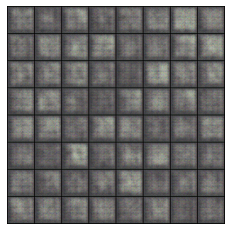

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [10/2000], loss_g: 1.4518, loss_d: 1.2009, real_score: 0.6287, fake_score: 0.4143
Saving generated-images-0010.png


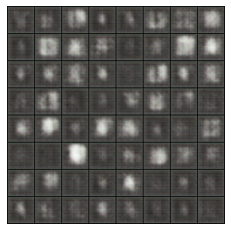

Saving:  model/generator/generator-0010.pth
Saving:  model/discriminator/discriminator-0010.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [11/2000], loss_g: 0.6313, loss_d: 1.2766, real_score: 0.7002, fake_score: 0.4763
Saving generated-images-0011.png


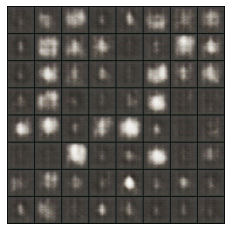

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [12/2000], loss_g: 2.9085, loss_d: 1.1324, real_score: 0.6353, fake_score: 0.3186
Saving generated-images-0012.png


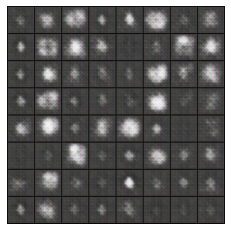

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [13/2000], loss_g: 3.9728, loss_d: 1.0436, real_score: 0.7162, fake_score: 0.3167
Saving generated-images-0013.png


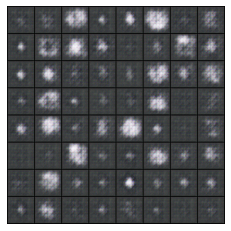

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [14/2000], loss_g: 4.4621, loss_d: 0.9974, real_score: 0.7533, fake_score: 0.3099
Saving generated-images-0014.png


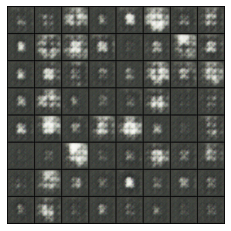

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [15/2000], loss_g: 2.4434, loss_d: 1.5526, real_score: 0.8025, fake_score: 0.6739
Saving generated-images-0015.png


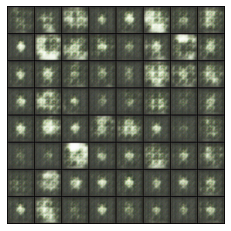

Saving:  model/generator/generator-0015.pth
Saving:  model/discriminator/discriminator-0015.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [16/2000], loss_g: 3.2768, loss_d: 1.2240, real_score: 0.5301, fake_score: 0.3256
Saving generated-images-0016.png


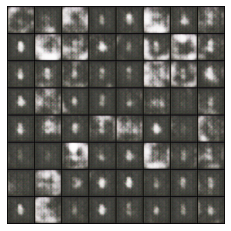

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [17/2000], loss_g: 4.2655, loss_d: 0.9919, real_score: 0.7629, fake_score: 0.3135
Saving generated-images-0017.png


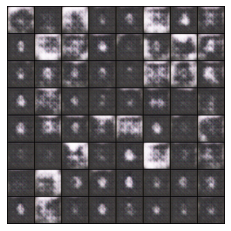

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [18/2000], loss_g: 4.3300, loss_d: 1.0280, real_score: 0.7099, fake_score: 0.3125
Saving generated-images-0018.png


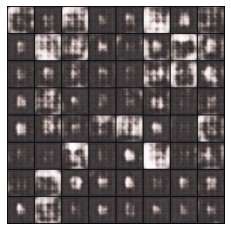

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [19/2000], loss_g: 3.2083, loss_d: 1.0513, real_score: 0.7206, fake_score: 0.3771
Saving generated-images-0019.png


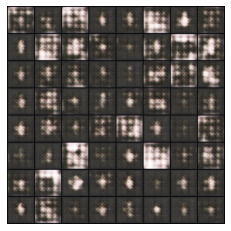

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [20/2000], loss_g: 3.7024, loss_d: 1.0120, real_score: 0.7459, fake_score: 0.3372
Saving generated-images-0020.png


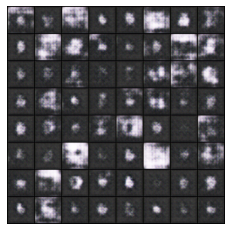

Saving:  model/generator/generator-0020.pth
Saving:  model/discriminator/discriminator-0020.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [21/2000], loss_g: 3.6075, loss_d: 1.0511, real_score: 0.7888, fake_score: 0.3651
Saving generated-images-0021.png


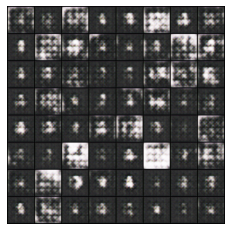

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [22/2000], loss_g: 4.4297, loss_d: 1.0262, real_score: 0.7607, fake_score: 0.3068
Saving generated-images-0022.png


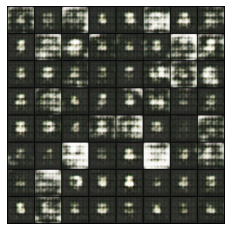

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [23/2000], loss_g: 4.6744, loss_d: 0.9972, real_score: 0.7629, fake_score: 0.3060
Saving generated-images-0023.png


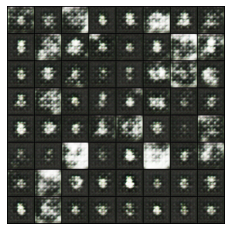

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [24/2000], loss_g: 1.3493, loss_d: 1.5810, real_score: 0.7697, fake_score: 0.7074
Saving generated-images-0024.png


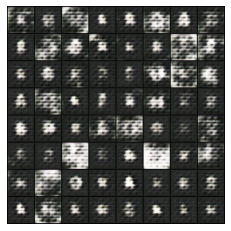

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [25/2000], loss_g: 4.1249, loss_d: 0.9799, real_score: 0.7795, fake_score: 0.3283
Saving generated-images-0025.png


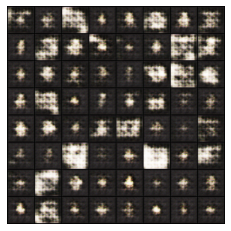

Saving:  model/generator/generator-0025.pth
Saving:  model/discriminator/discriminator-0025.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [26/2000], loss_g: 4.7980, loss_d: 1.0189, real_score: 0.8011, fake_score: 0.3200
Saving generated-images-0026.png


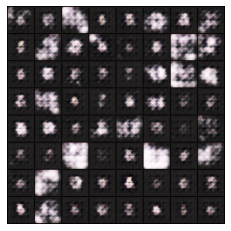

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [27/2000], loss_g: 0.5004, loss_d: 1.1590, real_score: 0.7987, fake_score: 0.5042
Saving generated-images-0027.png


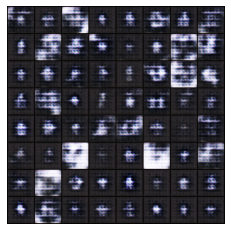

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [28/2000], loss_g: 1.4466, loss_d: 1.1748, real_score: 0.7878, fake_score: 0.4909
Saving generated-images-0028.png


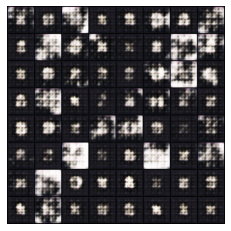

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [29/2000], loss_g: 2.7620, loss_d: 1.1004, real_score: 0.7471, fake_score: 0.3886
Saving generated-images-0029.png


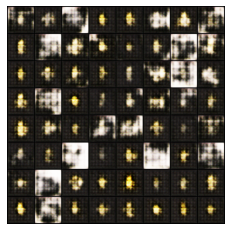

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [30/2000], loss_g: 0.3731, loss_d: 1.0784, real_score: 0.7978, fake_score: 0.3922
Saving generated-images-0030.png


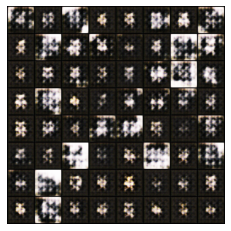

Saving:  model/generator/generator-0030.pth
Saving:  model/discriminator/discriminator-0030.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [31/2000], loss_g: 2.7592, loss_d: 1.0229, real_score: 0.7668, fake_score: 0.3457
Saving generated-images-0031.png


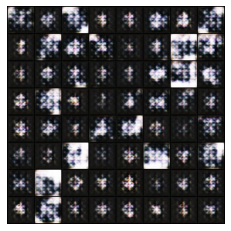

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [32/2000], loss_g: 2.9019, loss_d: 1.0544, real_score: 0.6874, fake_score: 0.3247
Saving generated-images-0032.png


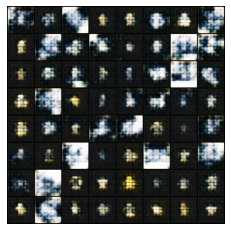

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [33/2000], loss_g: 3.1285, loss_d: 1.0241, real_score: 0.7630, fake_score: 0.3588
Saving generated-images-0033.png


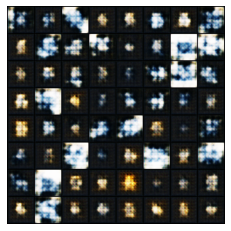

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [34/2000], loss_g: 2.3949, loss_d: 1.1724, real_score: 0.7896, fake_score: 0.4693
Saving generated-images-0034.png


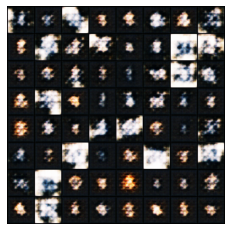

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [35/2000], loss_g: 2.8059, loss_d: 1.0923, real_score: 0.6318, fake_score: 0.2988
Saving generated-images-0035.png


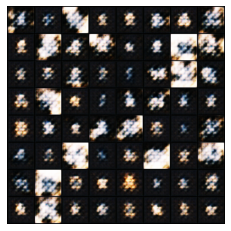

Saving:  model/generator/generator-0035.pth
Saving:  model/discriminator/discriminator-0035.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [36/2000], loss_g: 2.1984, loss_d: 1.1024, real_score: 0.7421, fake_score: 0.3917
Saving generated-images-0036.png


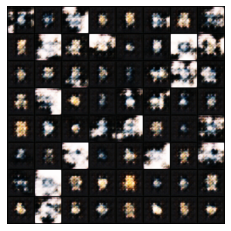

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [37/2000], loss_g: 2.2332, loss_d: 1.1104, real_score: 0.7358, fake_score: 0.4263
Saving generated-images-0037.png


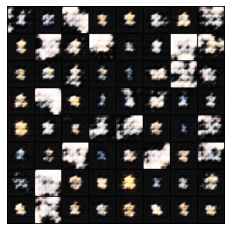

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [38/2000], loss_g: 0.1082, loss_d: 1.2129, real_score: 0.7553, fake_score: 0.5249
Saving generated-images-0038.png


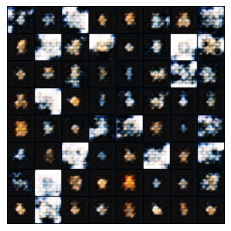

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [39/2000], loss_g: 0.3700, loss_d: 1.3406, real_score: 0.7610, fake_score: 0.5858
Saving generated-images-0039.png


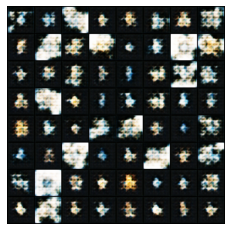

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [40/2000], loss_g: 2.6522, loss_d: 1.1554, real_score: 0.6516, fake_score: 0.3989
Saving generated-images-0040.png


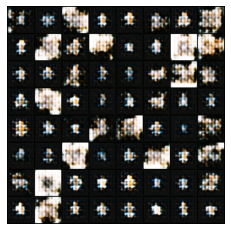

Saving:  model/generator/generator-0040.pth
Saving:  model/discriminator/discriminator-0040.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [41/2000], loss_g: 2.2719, loss_d: 1.0557, real_score: 0.7040, fake_score: 0.3493
Saving generated-images-0041.png


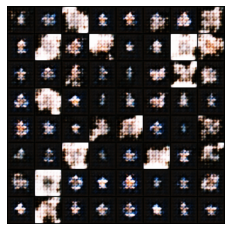

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [42/2000], loss_g: 3.5325, loss_d: 0.9630, real_score: 0.7808, fake_score: 0.3829
Saving generated-images-0042.png


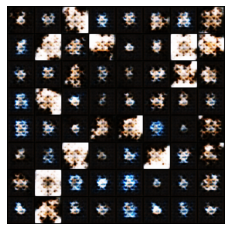

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [43/2000], loss_g: 2.3492, loss_d: 1.0217, real_score: 0.7022, fake_score: 0.3376
Saving generated-images-0043.png


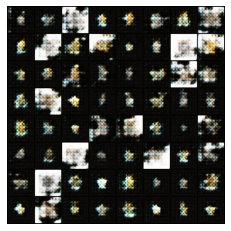

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [44/2000], loss_g: 3.3393, loss_d: 1.0783, real_score: 0.6697, fake_score: 0.3097
Saving generated-images-0044.png


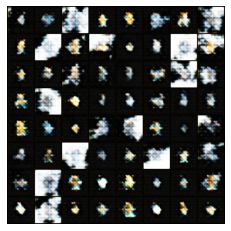

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [45/2000], loss_g: 1.4717, loss_d: 1.1051, real_score: 0.6361, fake_score: 0.3284
Saving generated-images-0045.png


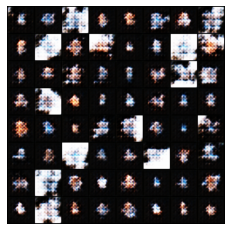

Saving:  model/generator/generator-0045.pth
Saving:  model/discriminator/discriminator-0045.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [46/2000], loss_g: 0.0180, loss_d: 1.3649, real_score: 0.7940, fake_score: 0.6254
Saving generated-images-0046.png


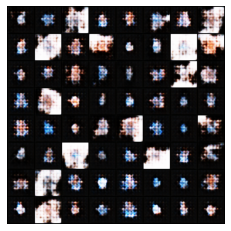

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [47/2000], loss_g: 3.2312, loss_d: 1.1574, real_score: 0.5743, fake_score: 0.3199
Saving generated-images-0047.png


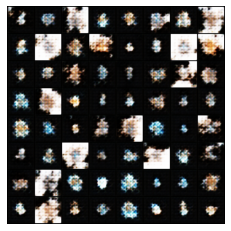

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [48/2000], loss_g: 2.5624, loss_d: 1.1729, real_score: 0.7531, fake_score: 0.4595
Saving generated-images-0048.png


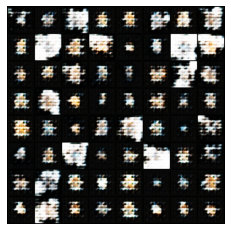

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [49/2000], loss_g: 1.6996, loss_d: 1.2536, real_score: 0.4588, fake_score: 0.2893
Saving generated-images-0049.png


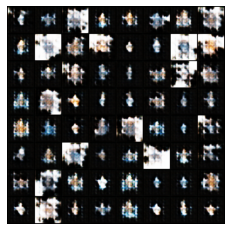

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [50/2000], loss_g: 3.2775, loss_d: 1.0831, real_score: 0.6850, fake_score: 0.3459
Saving generated-images-0050.png


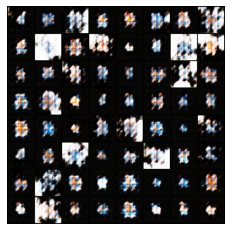

Saving:  model/generator/generator-0050.pth
Saving:  model/discriminator/discriminator-0050.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [51/2000], loss_g: 2.9970, loss_d: 1.0973, real_score: 0.6023, fake_score: 0.3010
Saving generated-images-0051.png


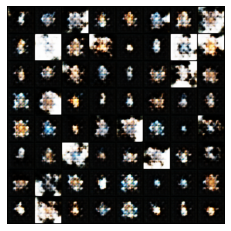

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [52/2000], loss_g: 2.3182, loss_d: 1.1105, real_score: 0.7686, fake_score: 0.4526
Saving generated-images-0052.png


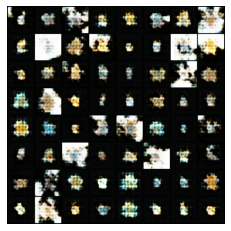

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [53/2000], loss_g: 3.1404, loss_d: 0.9702, real_score: 0.7602, fake_score: 0.3436
Saving generated-images-0053.png


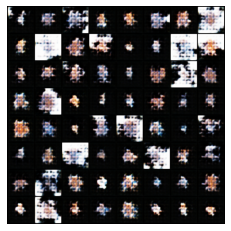

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [54/2000], loss_g: 3.8137, loss_d: 1.0314, real_score: 0.7366, fake_score: 0.3535
Saving generated-images-0054.png


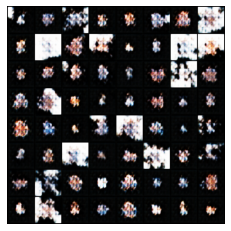

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [55/2000], loss_g: 2.3545, loss_d: 1.1391, real_score: 0.5884, fake_score: 0.3663
Saving generated-images-0055.png


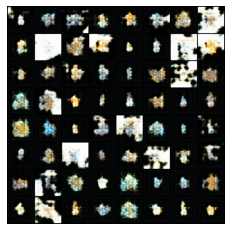

Saving:  model/generator/generator-0055.pth
Saving:  model/discriminator/discriminator-0055.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [56/2000], loss_g: 0.4858, loss_d: 1.2078, real_score: 0.7192, fake_score: 0.4702
Saving generated-images-0056.png


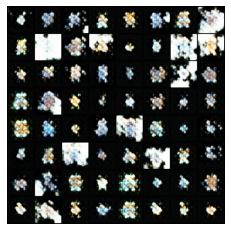

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [57/2000], loss_g: 1.5965, loss_d: 1.1376, real_score: 0.7440, fake_score: 0.3979
Saving generated-images-0057.png


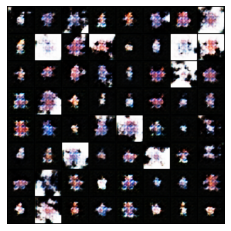

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [58/2000], loss_g: 1.6367, loss_d: 1.1592, real_score: 0.5898, fake_score: 0.3462
Saving generated-images-0058.png


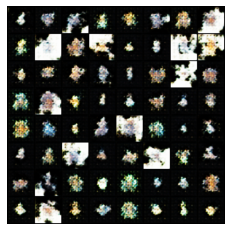

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [59/2000], loss_g: 1.1183, loss_d: 1.1996, real_score: 0.7128, fake_score: 0.4604
Saving generated-images-0059.png


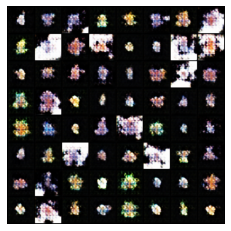

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [60/2000], loss_g: 2.5271, loss_d: 1.0563, real_score: 0.7642, fake_score: 0.4283
Saving generated-images-0060.png


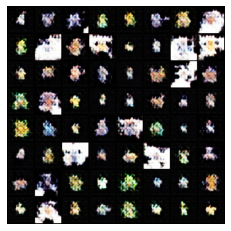

Saving:  model/generator/generator-0060.pth
Saving:  model/discriminator/discriminator-0060.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [61/2000], loss_g: 1.8171, loss_d: 1.1547, real_score: 0.7301, fake_score: 0.4459
Saving generated-images-0061.png


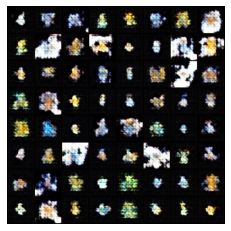

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [62/2000], loss_g: 0.4779, loss_d: 1.5004, real_score: 0.2938, fake_score: 0.2732
Saving generated-images-0062.png


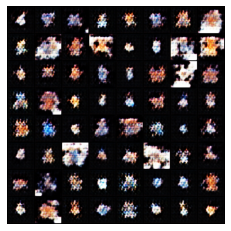

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [63/2000], loss_g: 1.9167, loss_d: 0.9997, real_score: 0.7595, fake_score: 0.3934
Saving generated-images-0063.png


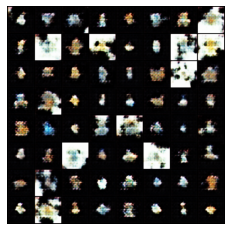

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [64/2000], loss_g: 1.5035, loss_d: 1.1126, real_score: 0.5819, fake_score: 0.2896
Saving generated-images-0064.png


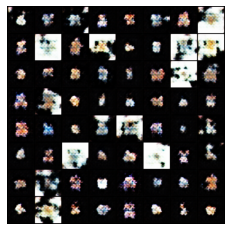

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [65/2000], loss_g: 2.1091, loss_d: 1.0726, real_score: 0.6407, fake_score: 0.2962
Saving generated-images-0065.png


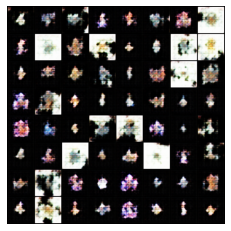

Saving:  model/generator/generator-0065.pth
Saving:  model/discriminator/discriminator-0065.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [66/2000], loss_g: 1.9985, loss_d: 1.0942, real_score: 0.6994, fake_score: 0.3283
Saving generated-images-0066.png


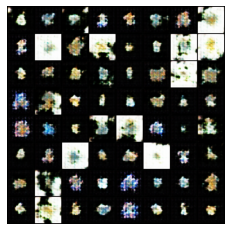

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [67/2000], loss_g: 1.4837, loss_d: 1.2749, real_score: 0.4932, fake_score: 0.3380
Saving generated-images-0067.png


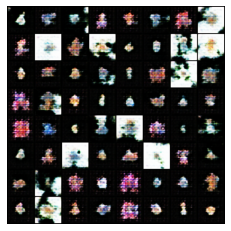

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [68/2000], loss_g: 1.1773, loss_d: 1.2310, real_score: 0.7475, fake_score: 0.4741
Saving generated-images-0068.png


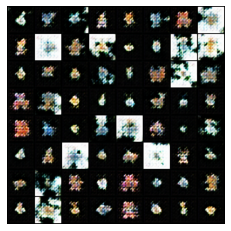

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [69/2000], loss_g: 0.5180, loss_d: 1.2049, real_score: 0.7118, fake_score: 0.4761
Saving generated-images-0069.png


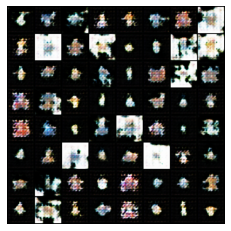

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [70/2000], loss_g: 3.3469, loss_d: 1.0643, real_score: 0.6850, fake_score: 0.3746
Saving generated-images-0070.png


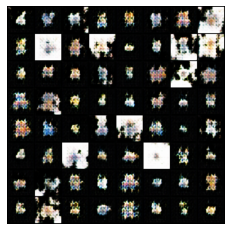

Saving:  model/generator/generator-0070.pth
Saving:  model/discriminator/discriminator-0070.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [71/2000], loss_g: 1.9295, loss_d: 1.3673, real_score: 0.4881, fake_score: 0.4277
Saving generated-images-0071.png


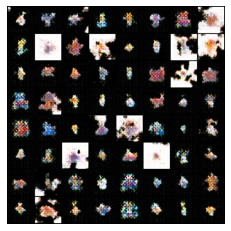

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [72/2000], loss_g: 2.9041, loss_d: 1.1445, real_score: 0.5326, fake_score: 0.2993
Saving generated-images-0072.png


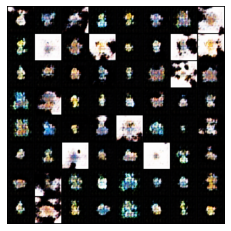

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [73/2000], loss_g: 3.2829, loss_d: 1.0200, real_score: 0.7349, fake_score: 0.3143
Saving generated-images-0073.png


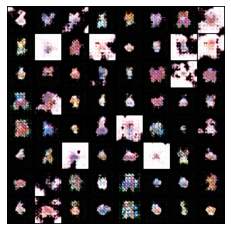

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [74/2000], loss_g: 2.2048, loss_d: 1.0412, real_score: 0.6957, fake_score: 0.3049
Saving generated-images-0074.png


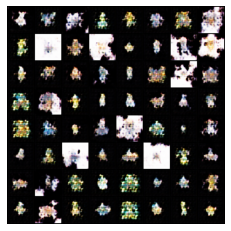

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [75/2000], loss_g: 1.7167, loss_d: 1.0549, real_score: 0.6935, fake_score: 0.3070
Saving generated-images-0075.png


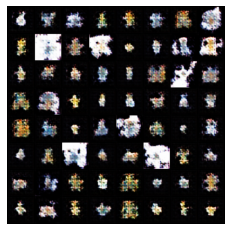

Saving:  model/generator/generator-0075.pth
Saving:  model/discriminator/discriminator-0075.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [76/2000], loss_g: 2.4133, loss_d: 1.0906, real_score: 0.6496, fake_score: 0.3022
Saving generated-images-0076.png


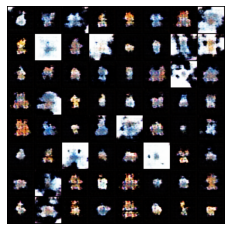

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [77/2000], loss_g: 1.3402, loss_d: 1.0648, real_score: 0.7136, fake_score: 0.3352
Saving generated-images-0077.png


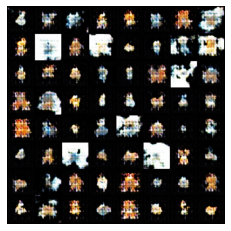

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [78/2000], loss_g: 3.9837, loss_d: 1.1141, real_score: 0.6046, fake_score: 0.3535
Saving generated-images-0078.png


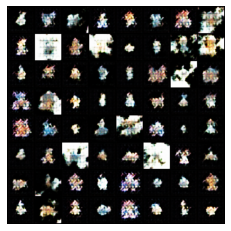

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [79/2000], loss_g: 2.1503, loss_d: 1.1815, real_score: 0.8005, fake_score: 0.5196
Saving generated-images-0079.png


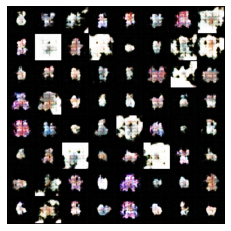

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [80/2000], loss_g: 3.4804, loss_d: 1.3686, real_score: 0.3786, fake_score: 0.2676
Saving generated-images-0080.png


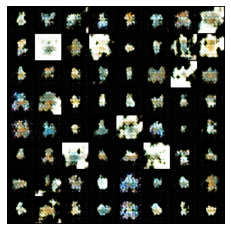

Saving:  model/generator/generator-0080.pth
Saving:  model/discriminator/discriminator-0080.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [81/2000], loss_g: 2.9319, loss_d: 1.1957, real_score: 0.4993, fake_score: 0.2862
Saving generated-images-0081.png


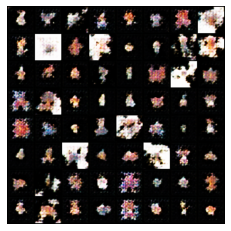

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [82/2000], loss_g: 3.0351, loss_d: 1.1135, real_score: 0.6436, fake_score: 0.3216
Saving generated-images-0082.png


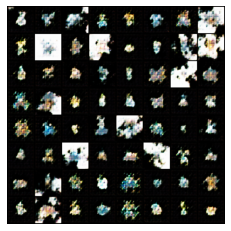

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [83/2000], loss_g: 1.7573, loss_d: 1.2244, real_score: 0.5302, fake_score: 0.3298
Saving generated-images-0083.png


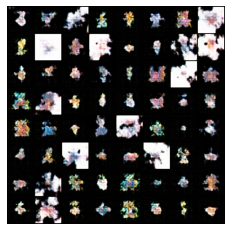

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [84/2000], loss_g: 1.7104, loss_d: 1.1859, real_score: 0.7562, fake_score: 0.5022
Saving generated-images-0084.png


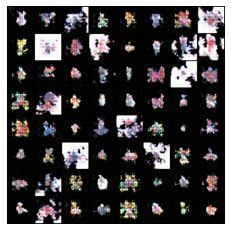

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [85/2000], loss_g: 0.1732, loss_d: 1.3093, real_score: 0.7316, fake_score: 0.5645
Saving generated-images-0085.png


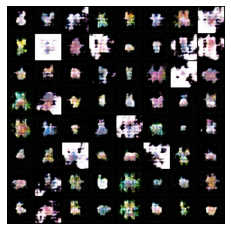

Saving:  model/generator/generator-0085.pth
Saving:  model/discriminator/discriminator-0085.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [86/2000], loss_g: 2.6268, loss_d: 1.1409, real_score: 0.5680, fake_score: 0.2794
Saving generated-images-0086.png


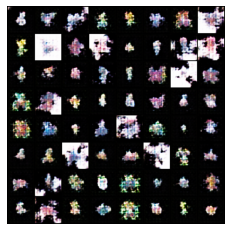

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [87/2000], loss_g: 3.0810, loss_d: 1.2265, real_score: 0.5389, fake_score: 0.3113
Saving generated-images-0087.png


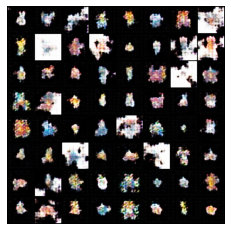

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [88/2000], loss_g: 0.8262, loss_d: 1.0997, real_score: 0.6894, fake_score: 0.3228
Saving generated-images-0088.png


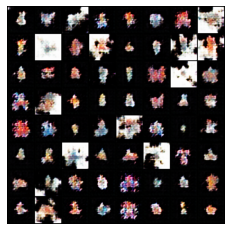

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [89/2000], loss_g: 2.7479, loss_d: 1.0637, real_score: 0.7854, fake_score: 0.4406
Saving generated-images-0089.png


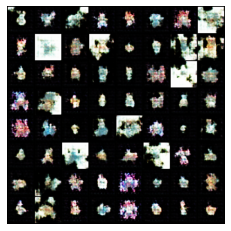

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [90/2000], loss_g: 1.5751, loss_d: 1.1579, real_score: 0.6485, fake_score: 0.3974
Saving generated-images-0090.png


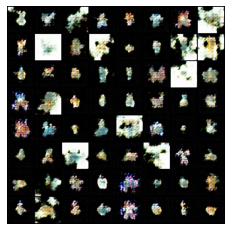

Saving:  model/generator/generator-0090.pth
Saving:  model/discriminator/discriminator-0090.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [91/2000], loss_g: 3.3539, loss_d: 1.0431, real_score: 0.6856, fake_score: 0.3311
Saving generated-images-0091.png


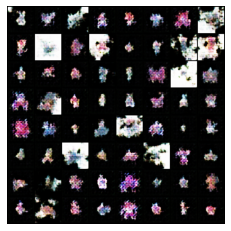

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [92/2000], loss_g: 4.0131, loss_d: 1.1297, real_score: 0.6220, fake_score: 0.2990
Saving generated-images-0092.png


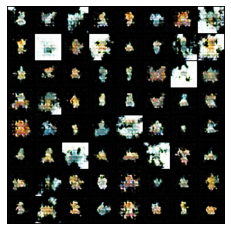

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [93/2000], loss_g: 3.7208, loss_d: 1.0566, real_score: 0.6402, fake_score: 0.2826
Saving generated-images-0093.png


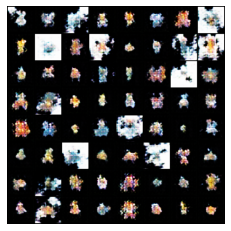

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [94/2000], loss_g: 0.4849, loss_d: 1.1405, real_score: 0.5951, fake_score: 0.2720
Saving generated-images-0094.png


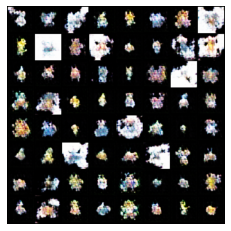

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [95/2000], loss_g: 2.4981, loss_d: 1.0872, real_score: 0.7542, fake_score: 0.3639
Saving generated-images-0095.png


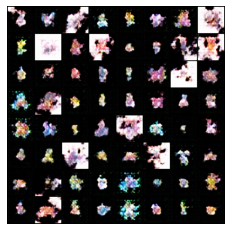

Saving:  model/generator/generator-0095.pth
Saving:  model/discriminator/discriminator-0095.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [96/2000], loss_g: 3.1500, loss_d: 1.1035, real_score: 0.6549, fake_score: 0.3290
Saving generated-images-0096.png


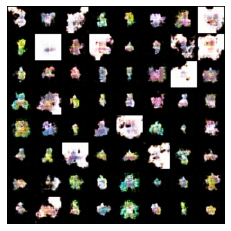

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [97/2000], loss_g: 2.0767, loss_d: 1.0339, real_score: 0.7668, fake_score: 0.3773
Saving generated-images-0097.png


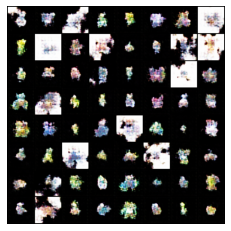

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [98/2000], loss_g: 4.2362, loss_d: 1.0715, real_score: 0.6866, fake_score: 0.3353
Saving generated-images-0098.png


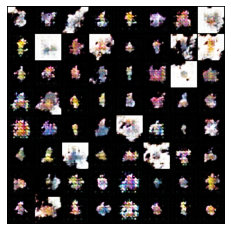

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [99/2000], loss_g: 1.7846, loss_d: 1.1585, real_score: 0.5772, fake_score: 0.2896
Saving generated-images-0099.png


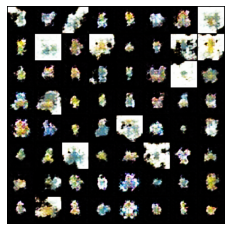

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [100/2000], loss_g: 0.8115, loss_d: 1.1348, real_score: 0.7140, fake_score: 0.3592
Saving generated-images-0100.png


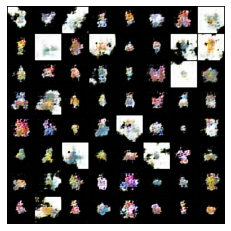

Saving:  model/generator/generator-0100.pth
Saving:  model/discriminator/discriminator-0100.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [101/2000], loss_g: 3.1642, loss_d: 1.0139, real_score: 0.7214, fake_score: 0.3130
Saving generated-images-0101.png


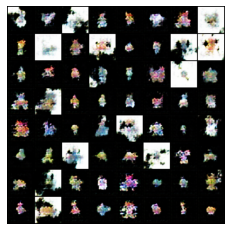

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [102/2000], loss_g: 2.5838, loss_d: 1.0975, real_score: 0.7268, fake_score: 0.3569
Saving generated-images-0102.png


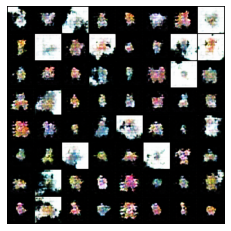

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [103/2000], loss_g: 3.9780, loss_d: 1.3086, real_score: 0.4747, fake_score: 0.2838
Saving generated-images-0103.png


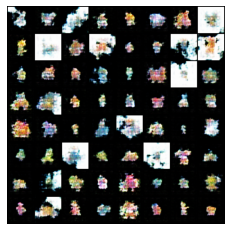

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [104/2000], loss_g: 0.4094, loss_d: 1.2073, real_score: 0.7466, fake_score: 0.5028
Saving generated-images-0104.png


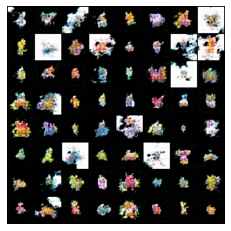

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [105/2000], loss_g: 2.3817, loss_d: 1.1378, real_score: 0.7189, fake_score: 0.4308
Saving generated-images-0105.png


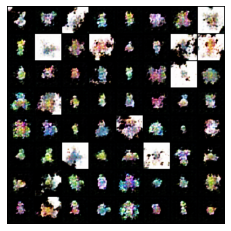

Saving:  model/generator/generator-0105.pth
Saving:  model/discriminator/discriminator-0105.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [106/2000], loss_g: 2.8751, loss_d: 1.0656, real_score: 0.7239, fake_score: 0.3641
Saving generated-images-0106.png


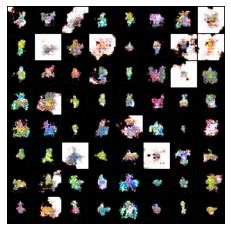

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [107/2000], loss_g: 2.7720, loss_d: 1.0291, real_score: 0.7220, fake_score: 0.3028
Saving generated-images-0107.png


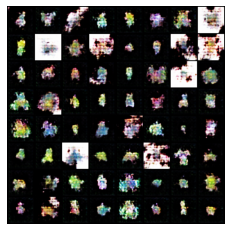

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [108/2000], loss_g: 2.1613, loss_d: 1.1640, real_score: 0.5868, fake_score: 0.3389
Saving generated-images-0108.png


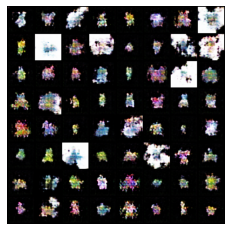

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [109/2000], loss_g: 0.8893, loss_d: 1.0616, real_score: 0.7713, fake_score: 0.4251
Saving generated-images-0109.png


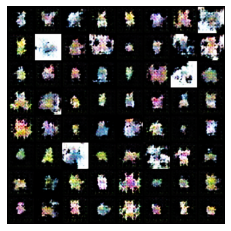

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [110/2000], loss_g: 2.7841, loss_d: 1.1089, real_score: 0.6141, fake_score: 0.2997
Saving generated-images-0110.png


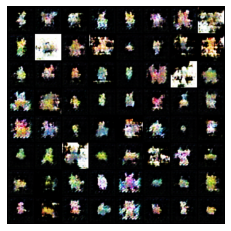

Saving:  model/generator/generator-0110.pth
Saving:  model/discriminator/discriminator-0110.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [111/2000], loss_g: 4.6384, loss_d: 1.1058, real_score: 0.8018, fake_score: 0.3974
Saving generated-images-0111.png


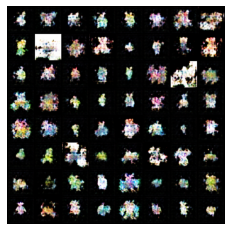

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [112/2000], loss_g: 3.7859, loss_d: 1.1068, real_score: 0.5961, fake_score: 0.2680
Saving generated-images-0112.png


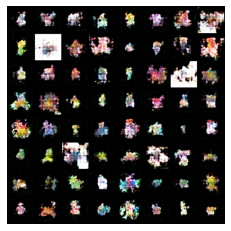

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [113/2000], loss_g: 2.9167, loss_d: 1.0431, real_score: 0.7510, fake_score: 0.3360
Saving generated-images-0113.png


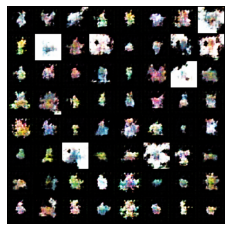

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [114/2000], loss_g: 0.2697, loss_d: 1.1779, real_score: 0.7373, fake_score: 0.4559
Saving generated-images-0114.png


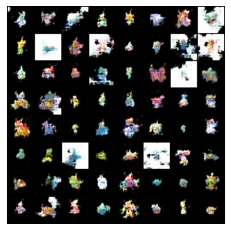

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [115/2000], loss_g: 2.9575, loss_d: 1.0532, real_score: 0.7188, fake_score: 0.3800
Saving generated-images-0115.png


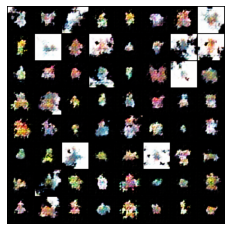

Saving:  model/generator/generator-0115.pth
Saving:  model/discriminator/discriminator-0115.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [116/2000], loss_g: 1.8748, loss_d: 1.0892, real_score: 0.7381, fake_score: 0.4024
Saving generated-images-0116.png


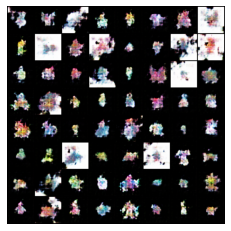

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [117/2000], loss_g: 3.4649, loss_d: 1.0348, real_score: 0.6881, fake_score: 0.2727
Saving generated-images-0117.png


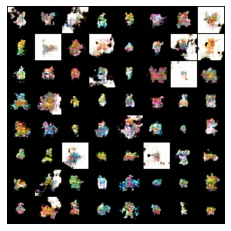

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [118/2000], loss_g: 4.2386, loss_d: 1.0778, real_score: 0.6365, fake_score: 0.3199
Saving generated-images-0118.png


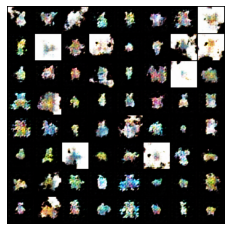

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [119/2000], loss_g: 1.5994, loss_d: 1.2419, real_score: 0.7774, fake_score: 0.5492
Saving generated-images-0119.png


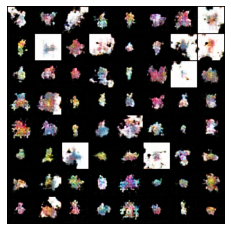

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [120/2000], loss_g: 4.8525, loss_d: 1.1032, real_score: 0.5722, fake_score: 0.3024
Saving generated-images-0120.png


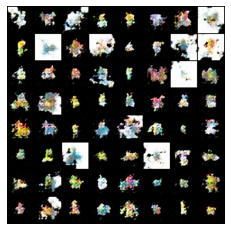

Saving:  model/generator/generator-0120.pth
Saving:  model/discriminator/discriminator-0120.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [121/2000], loss_g: 2.5330, loss_d: 1.0580, real_score: 0.7676, fake_score: 0.3988
Saving generated-images-0121.png


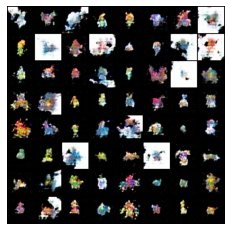

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [122/2000], loss_g: 2.7263, loss_d: 1.0542, real_score: 0.7561, fake_score: 0.3335
Saving generated-images-0122.png


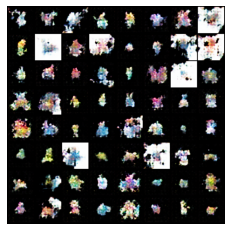

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [123/2000], loss_g: 2.2515, loss_d: 1.0569, real_score: 0.7312, fake_score: 0.3356
Saving generated-images-0123.png


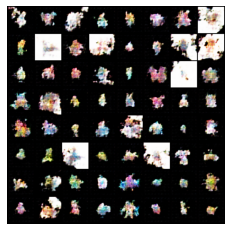

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [124/2000], loss_g: 2.1493, loss_d: 1.1431, real_score: 0.7474, fake_score: 0.4634
Saving generated-images-0124.png


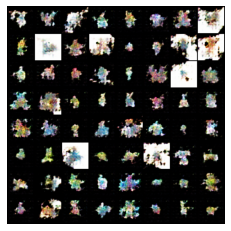

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [125/2000], loss_g: 1.1307, loss_d: 1.3502, real_score: 0.7694, fake_score: 0.5722
Saving generated-images-0125.png


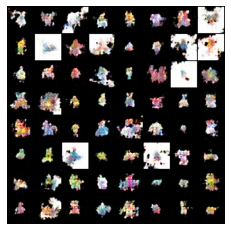

Saving:  model/generator/generator-0125.pth
Saving:  model/discriminator/discriminator-0125.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [126/2000], loss_g: 3.4950, loss_d: 1.1101, real_score: 0.7497, fake_score: 0.4246
Saving generated-images-0126.png


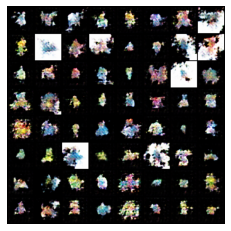

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [127/2000], loss_g: 4.7436, loss_d: 1.1284, real_score: 0.5888, fake_score: 0.2972
Saving generated-images-0127.png


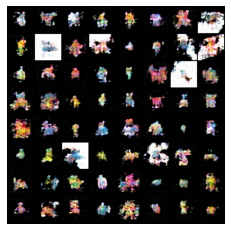

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [128/2000], loss_g: 2.5511, loss_d: 1.2907, real_score: 0.4299, fake_score: 0.2712
Saving generated-images-0128.png


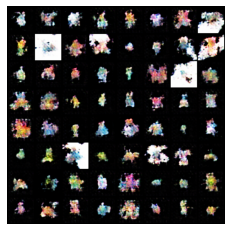

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [129/2000], loss_g: 2.2808, loss_d: 1.0554, real_score: 0.7998, fake_score: 0.4174
Saving generated-images-0129.png


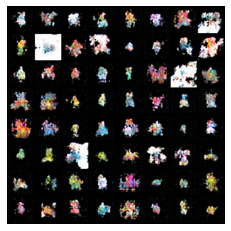

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [130/2000], loss_g: 3.6494, loss_d: 1.0932, real_score: 0.7627, fake_score: 0.4119
Saving generated-images-0130.png


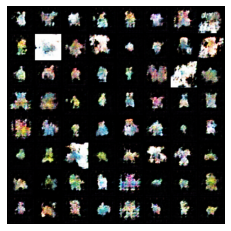

Saving:  model/generator/generator-0130.pth
Saving:  model/discriminator/discriminator-0130.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [131/2000], loss_g: 3.5768, loss_d: 1.0351, real_score: 0.7184, fake_score: 0.2839
Saving generated-images-0131.png


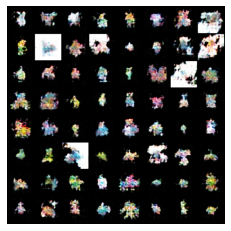

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [132/2000], loss_g: 4.5027, loss_d: 0.9964, real_score: 0.8023, fake_score: 0.3363
Saving generated-images-0132.png


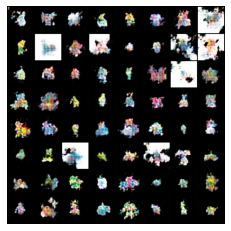

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [133/2000], loss_g: 4.5293, loss_d: 1.0133, real_score: 0.7579, fake_score: 0.3207
Saving generated-images-0133.png


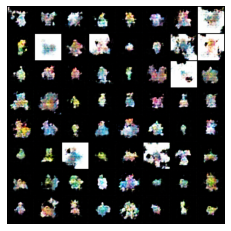

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [134/2000], loss_g: 1.4209, loss_d: 1.0147, real_score: 0.6855, fake_score: 0.2963
Saving generated-images-0134.png


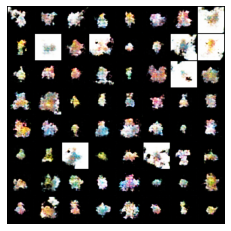

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [135/2000], loss_g: 2.1259, loss_d: 1.0363, real_score: 0.6832, fake_score: 0.2982
Saving generated-images-0135.png


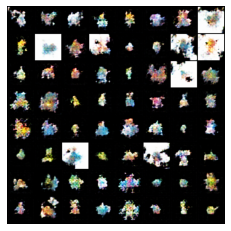

Saving:  model/generator/generator-0135.pth
Saving:  model/discriminator/discriminator-0135.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [136/2000], loss_g: 2.0361, loss_d: 1.0720, real_score: 0.7256, fake_score: 0.3586
Saving generated-images-0136.png


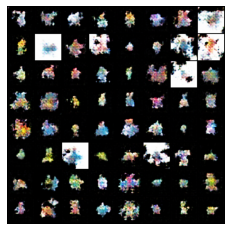

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [137/2000], loss_g: 0.9152, loss_d: 1.0095, real_score: 0.7866, fake_score: 0.3516
Saving generated-images-0137.png


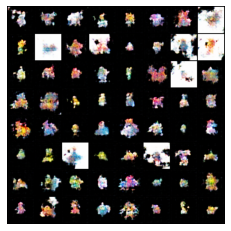

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [138/2000], loss_g: 4.1035, loss_d: 1.0019, real_score: 0.7572, fake_score: 0.2860
Saving generated-images-0138.png


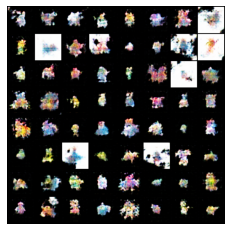

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [139/2000], loss_g: 5.2172, loss_d: 0.9506, real_score: 0.8041, fake_score: 0.3196
Saving generated-images-0139.png


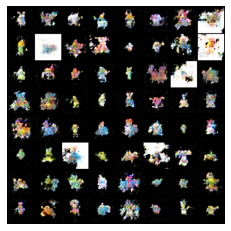

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [140/2000], loss_g: 4.5290, loss_d: 0.9808, real_score: 0.7950, fake_score: 0.2904
Saving generated-images-0140.png


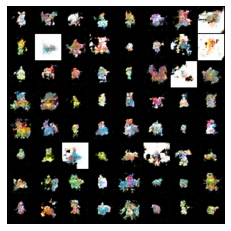

Saving:  model/generator/generator-0140.pth
Saving:  model/discriminator/discriminator-0140.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [141/2000], loss_g: 3.5540, loss_d: 1.0101, real_score: 0.7578, fake_score: 0.3503
Saving generated-images-0141.png


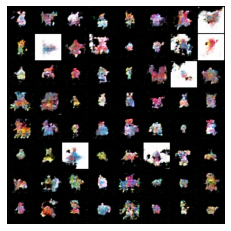

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [142/2000], loss_g: 5.2680, loss_d: 1.0078, real_score: 0.6703, fake_score: 0.2561
Saving generated-images-0142.png


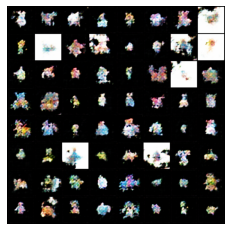

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [143/2000], loss_g: 1.1525, loss_d: 1.0081, real_score: 0.7693, fake_score: 0.3459
Saving generated-images-0143.png


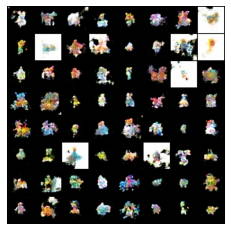

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [144/2000], loss_g: 3.6462, loss_d: 0.9309, real_score: 0.7537, fake_score: 0.2945
Saving generated-images-0144.png


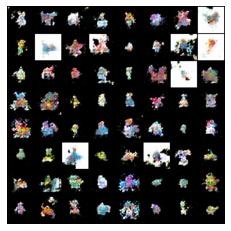

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [145/2000], loss_g: 3.3648, loss_d: 1.0292, real_score: 0.7941, fake_score: 0.3582
Saving generated-images-0145.png


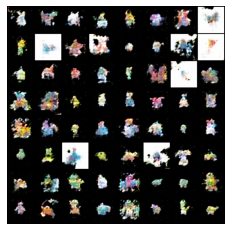

Saving:  model/generator/generator-0145.pth
Saving:  model/discriminator/discriminator-0145.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [146/2000], loss_g: 0.7677, loss_d: 1.3207, real_score: 0.7487, fake_score: 0.5214
Saving generated-images-0146.png


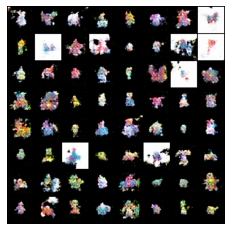

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [147/2000], loss_g: 3.6281, loss_d: 1.0193, real_score: 0.6826, fake_score: 0.2844
Saving generated-images-0147.png


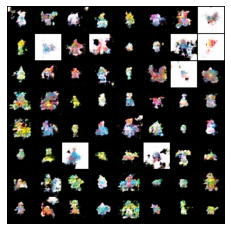

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [148/2000], loss_g: 4.1281, loss_d: 1.0445, real_score: 0.7565, fake_score: 0.3510
Saving generated-images-0148.png


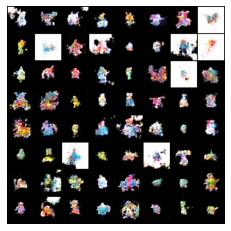

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [149/2000], loss_g: 5.9276, loss_d: 0.9407, real_score: 0.8115, fake_score: 0.3158
Saving generated-images-0149.png


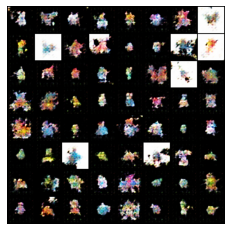

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [150/2000], loss_g: 4.3583, loss_d: 0.9312, real_score: 0.7638, fake_score: 0.2783
Saving generated-images-0150.png


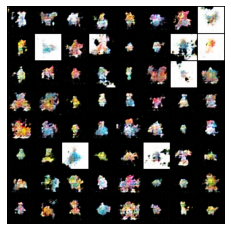

Saving:  model/generator/generator-0150.pth
Saving:  model/discriminator/discriminator-0150.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [151/2000], loss_g: 3.8224, loss_d: 1.0117, real_score: 0.7586, fake_score: 0.3359
Saving generated-images-0151.png


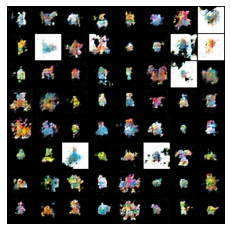

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [152/2000], loss_g: 4.9182, loss_d: 0.9921, real_score: 0.7614, fake_score: 0.3155
Saving generated-images-0152.png


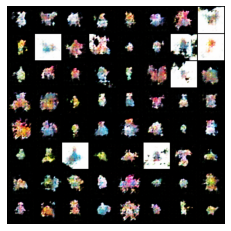

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [153/2000], loss_g: 0.4907, loss_d: 1.0052, real_score: 0.7559, fake_score: 0.2804
Saving generated-images-0153.png


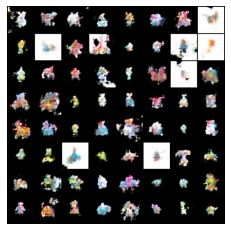

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [154/2000], loss_g: 2.9842, loss_d: 1.0576, real_score: 0.6943, fake_score: 0.3119
Saving generated-images-0154.png


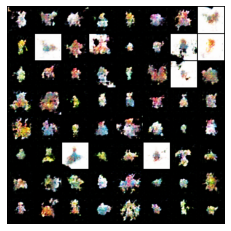

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [155/2000], loss_g: 5.0461, loss_d: 1.0054, real_score: 0.7391, fake_score: 0.2726
Saving generated-images-0155.png


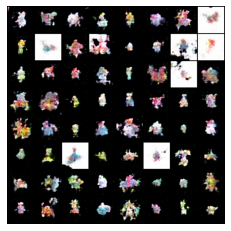

Saving:  model/generator/generator-0155.pth
Saving:  model/discriminator/discriminator-0155.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [156/2000], loss_g: 3.6074, loss_d: 0.9753, real_score: 0.7849, fake_score: 0.2702
Saving generated-images-0156.png


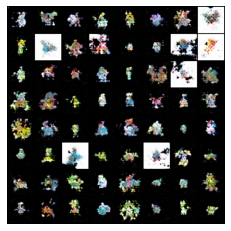

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [157/2000], loss_g: 4.4833, loss_d: 1.0382, real_score: 0.7282, fake_score: 0.3613
Saving generated-images-0157.png


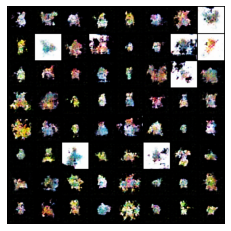

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [158/2000], loss_g: 3.5883, loss_d: 1.0102, real_score: 0.7983, fake_score: 0.3021
Saving generated-images-0158.png


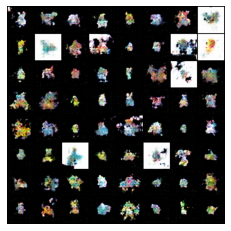

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [159/2000], loss_g: 5.1123, loss_d: 0.9892, real_score: 0.7709, fake_score: 0.2845
Saving generated-images-0159.png


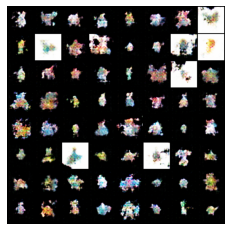

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [160/2000], loss_g: 2.8124, loss_d: 1.1132, real_score: 0.7089, fake_score: 0.3540
Saving generated-images-0160.png


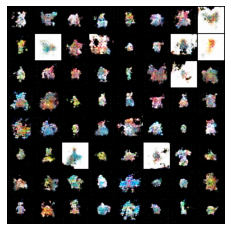

Saving:  model/generator/generator-0160.pth
Saving:  model/discriminator/discriminator-0160.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [161/2000], loss_g: 1.2360, loss_d: 1.1734, real_score: 0.8004, fake_score: 0.4917
Saving generated-images-0161.png


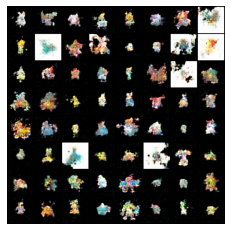

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [162/2000], loss_g: 3.2510, loss_d: 0.9915, real_score: 0.7800, fake_score: 0.3327
Saving generated-images-0162.png


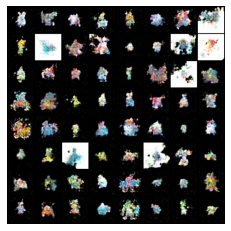

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [163/2000], loss_g: 4.6608, loss_d: 1.0353, real_score: 0.7534, fake_score: 0.3347
Saving generated-images-0163.png


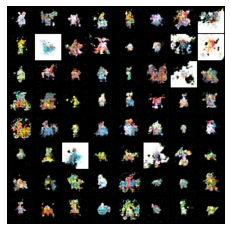

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [164/2000], loss_g: 4.4854, loss_d: 1.0620, real_score: 0.6491, fake_score: 0.2705
Saving generated-images-0164.png


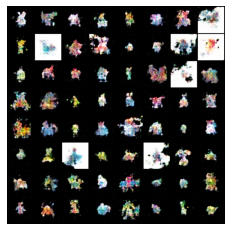

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [165/2000], loss_g: 5.0036, loss_d: 1.0157, real_score: 0.7337, fake_score: 0.2647
Saving generated-images-0165.png


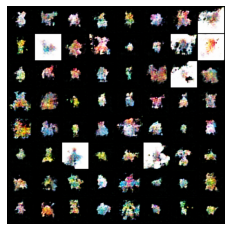

Saving:  model/generator/generator-0165.pth
Saving:  model/discriminator/discriminator-0165.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [166/2000], loss_g: 3.1152, loss_d: 1.0021, real_score: 0.7719, fake_score: 0.2988
Saving generated-images-0166.png


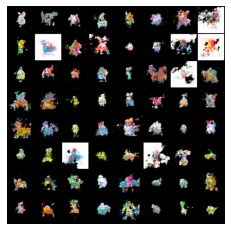

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [167/2000], loss_g: 3.5870, loss_d: 1.4046, real_score: 0.3801, fake_score: 0.2377
Saving generated-images-0167.png


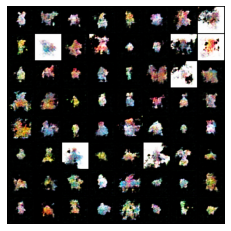

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [168/2000], loss_g: 3.4946, loss_d: 0.9623, real_score: 0.7598, fake_score: 0.2881
Saving generated-images-0168.png


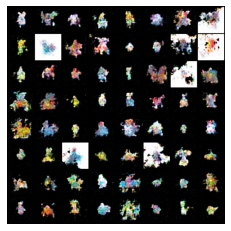

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [169/2000], loss_g: 6.5000, loss_d: 0.9322, real_score: 0.8012, fake_score: 0.2575
Saving generated-images-0169.png


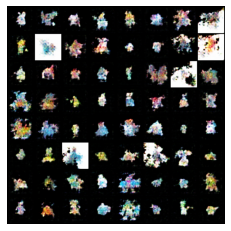

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [170/2000], loss_g: 1.7940, loss_d: 0.9599, real_score: 0.6786, fake_score: 0.2530
Saving generated-images-0170.png


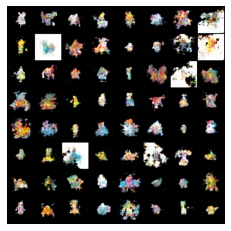

Saving:  model/generator/generator-0170.pth
Saving:  model/discriminator/discriminator-0170.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [171/2000], loss_g: 5.0483, loss_d: 0.9466, real_score: 0.7072, fake_score: 0.2782
Saving generated-images-0171.png


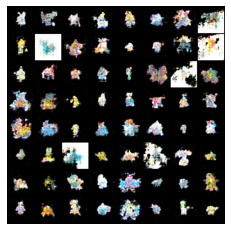

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [172/2000], loss_g: 5.1238, loss_d: 0.9608, real_score: 0.6844, fake_score: 0.2450
Saving generated-images-0172.png


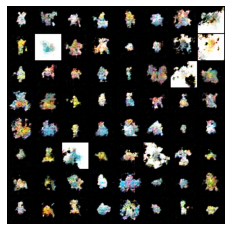

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [173/2000], loss_g: 4.0618, loss_d: 1.0375, real_score: 0.7854, fake_score: 0.3591
Saving generated-images-0173.png


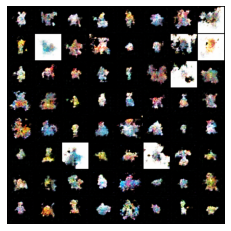

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [174/2000], loss_g: 1.8156, loss_d: 1.1372, real_score: 0.5470, fake_score: 0.2449
Saving generated-images-0174.png


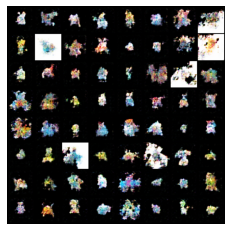

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [175/2000], loss_g: 5.5913, loss_d: 1.0988, real_score: 0.7986, fake_score: 0.3981
Saving generated-images-0175.png


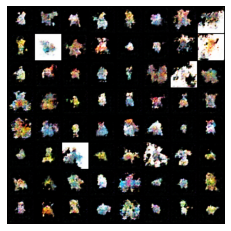

Saving:  model/generator/generator-0175.pth
Saving:  model/discriminator/discriminator-0175.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [176/2000], loss_g: 4.7673, loss_d: 1.0437, real_score: 0.7416, fake_score: 0.3477
Saving generated-images-0176.png


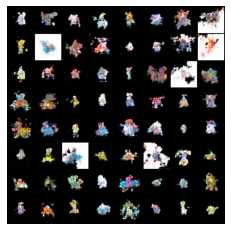

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [177/2000], loss_g: 4.3181, loss_d: 1.0544, real_score: 0.6857, fake_score: 0.2547
Saving generated-images-0177.png


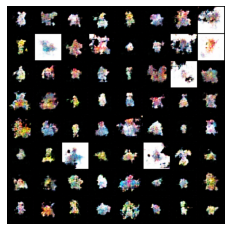

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [178/2000], loss_g: 4.8095, loss_d: 1.1855, real_score: 0.5594, fake_score: 0.3087
Saving generated-images-0178.png


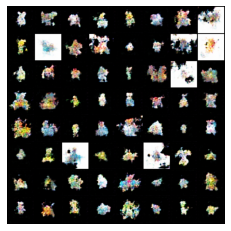

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [179/2000], loss_g: 1.4286, loss_d: 0.9600, real_score: 0.7942, fake_score: 0.2908
Saving generated-images-0179.png


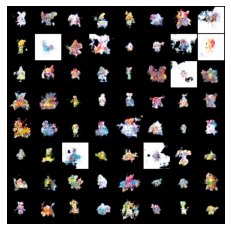

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [180/2000], loss_g: 0.3545, loss_d: 1.0137, real_score: 0.6860, fake_score: 0.2956
Saving generated-images-0180.png


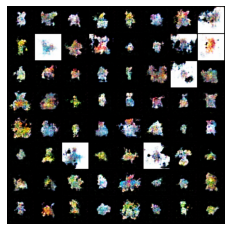

Saving:  model/generator/generator-0180.pth
Saving:  model/discriminator/discriminator-0180.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [181/2000], loss_g: 2.6693, loss_d: 1.0140, real_score: 0.7762, fake_score: 0.2838
Saving generated-images-0181.png


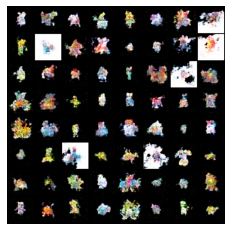

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [182/2000], loss_g: 5.2060, loss_d: 1.0448, real_score: 0.8099, fake_score: 0.3636
Saving generated-images-0182.png


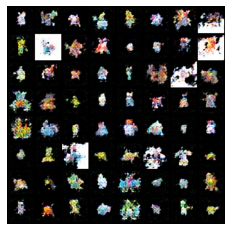

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [183/2000], loss_g: 3.8705, loss_d: 1.2437, real_score: 0.4684, fake_score: 0.3042
Saving generated-images-0183.png


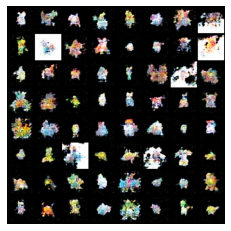

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [184/2000], loss_g: 4.4372, loss_d: 0.9996, real_score: 0.7640, fake_score: 0.3033
Saving generated-images-0184.png


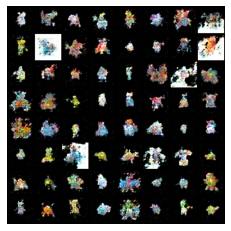

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [185/2000], loss_g: 4.5220, loss_d: 1.0355, real_score: 0.6781, fake_score: 0.3037
Saving generated-images-0185.png


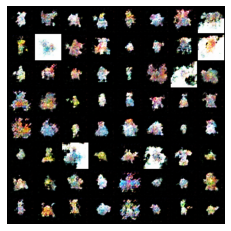

Saving:  model/generator/generator-0185.pth
Saving:  model/discriminator/discriminator-0185.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [186/2000], loss_g: 5.2996, loss_d: 1.0181, real_score: 0.7982, fake_score: 0.2753
Saving generated-images-0186.png


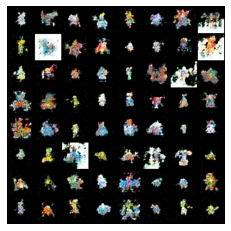

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [187/2000], loss_g: 5.0668, loss_d: 0.9802, real_score: 0.7007, fake_score: 0.2627
Saving generated-images-0187.png


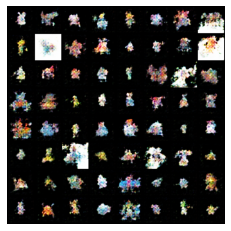

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [188/2000], loss_g: 5.9577, loss_d: 0.9507, real_score: 0.8026, fake_score: 0.2439
Saving generated-images-0188.png


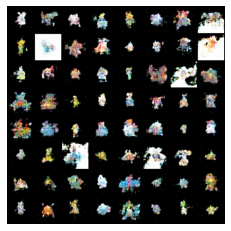

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [189/2000], loss_g: 3.4698, loss_d: 0.9548, real_score: 0.8147, fake_score: 0.2719
Saving generated-images-0189.png


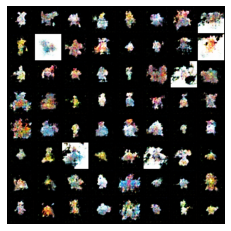

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [190/2000], loss_g: 5.6358, loss_d: 0.9853, real_score: 0.7945, fake_score: 0.2921
Saving generated-images-0190.png


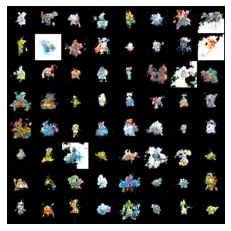

Saving:  model/generator/generator-0190.pth
Saving:  model/discriminator/discriminator-0190.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [191/2000], loss_g: 3.5990, loss_d: 1.0263, real_score: 0.7251, fake_score: 0.2773
Saving generated-images-0191.png


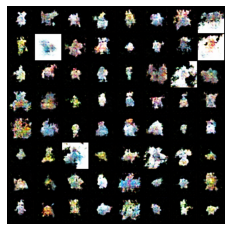

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [192/2000], loss_g: 4.1494, loss_d: 1.0830, real_score: 0.7564, fake_score: 0.3524
Saving generated-images-0192.png


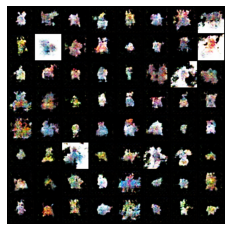

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [193/2000], loss_g: 5.3870, loss_d: 0.9608, real_score: 0.7604, fake_score: 0.2548
Saving generated-images-0193.png


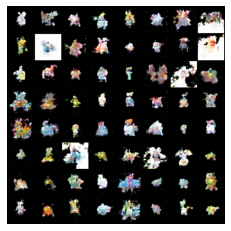

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [194/2000], loss_g: 0.6437, loss_d: 1.0161, real_score: 0.7786, fake_score: 0.3130
Saving generated-images-0194.png


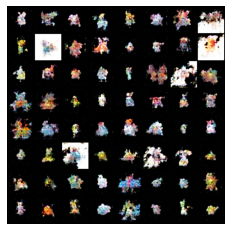

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [195/2000], loss_g: 2.4531, loss_d: 1.1666, real_score: 0.5410, fake_score: 0.2774
Saving generated-images-0195.png


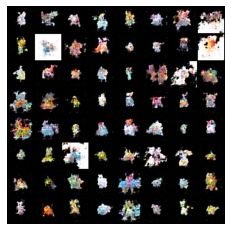

Saving:  model/generator/generator-0195.pth
Saving:  model/discriminator/discriminator-0195.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [196/2000], loss_g: 5.0055, loss_d: 1.0260, real_score: 0.7920, fake_score: 0.3522
Saving generated-images-0196.png


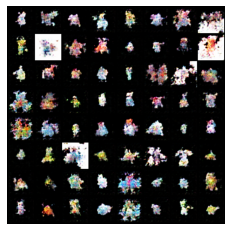

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [197/2000], loss_g: 2.2574, loss_d: 0.9762, real_score: 0.7054, fake_score: 0.2306
Saving generated-images-0197.png


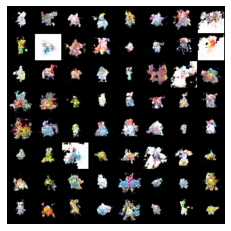

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [198/2000], loss_g: 6.2180, loss_d: 0.9412, real_score: 0.7534, fake_score: 0.2492
Saving generated-images-0198.png


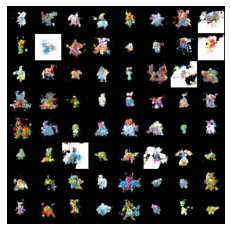

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [199/2000], loss_g: 3.9571, loss_d: 1.0500, real_score: 0.6641, fake_score: 0.2559
Saving generated-images-0199.png


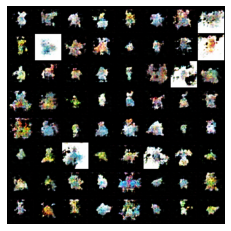

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [200/2000], loss_g: 3.9628, loss_d: 1.0318, real_score: 0.7697, fake_score: 0.3513
Saving generated-images-0200.png


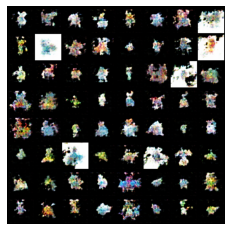

Saving:  model/generator/generator-0200.pth
Saving:  model/discriminator/discriminator-0200.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [201/2000], loss_g: 4.9354, loss_d: 1.0617, real_score: 0.6754, fake_score: 0.2663
Saving generated-images-0201.png


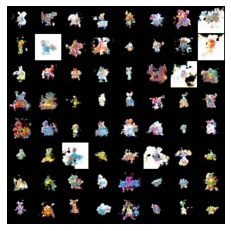

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [202/2000], loss_g: 5.8829, loss_d: 1.0377, real_score: 0.8312, fake_score: 0.3791
Saving generated-images-0202.png


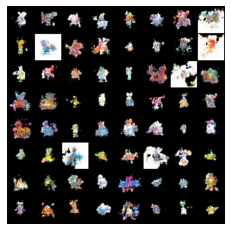

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [203/2000], loss_g: 4.5735, loss_d: 1.0446, real_score: 0.6715, fake_score: 0.2318
Saving generated-images-0203.png


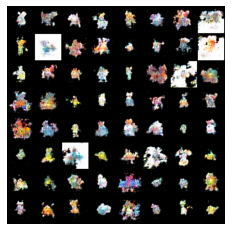

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [204/2000], loss_g: 5.6714, loss_d: 0.9806, real_score: 0.7950, fake_score: 0.2689
Saving generated-images-0204.png


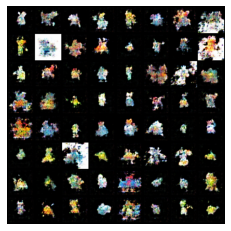

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [205/2000], loss_g: 5.2816, loss_d: 1.0372, real_score: 0.8202, fake_score: 0.3352
Saving generated-images-0205.png


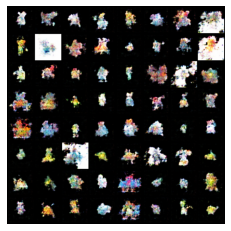

Saving:  model/generator/generator-0205.pth
Saving:  model/discriminator/discriminator-0205.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [206/2000], loss_g: 4.3655, loss_d: 1.0177, real_score: 0.7364, fake_score: 0.3214
Saving generated-images-0206.png


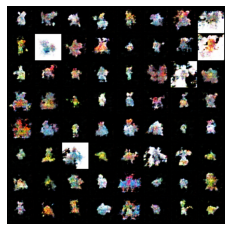

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [207/2000], loss_g: 3.7487, loss_d: 1.0040, real_score: 0.8082, fake_score: 0.2959
Saving generated-images-0207.png


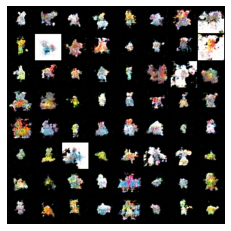

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [208/2000], loss_g: 4.1702, loss_d: 1.0088, real_score: 0.7088, fake_score: 0.2555
Saving generated-images-0208.png


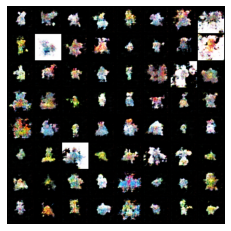

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [209/2000], loss_g: 5.5125, loss_d: 1.0427, real_score: 0.7994, fake_score: 0.3597
Saving generated-images-0209.png


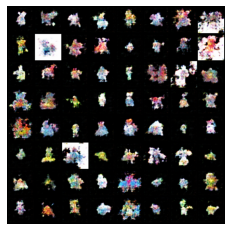

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [210/2000], loss_g: 6.1760, loss_d: 0.9675, real_score: 0.7537, fake_score: 0.2543
Saving generated-images-0210.png


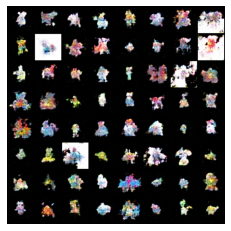

Saving:  model/generator/generator-0210.pth
Saving:  model/discriminator/discriminator-0210.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [211/2000], loss_g: 5.3178, loss_d: 1.0215, real_score: 0.7548, fake_score: 0.3028
Saving generated-images-0211.png


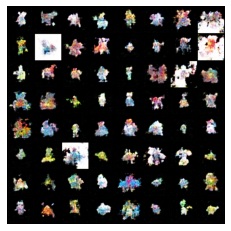

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [212/2000], loss_g: 2.5690, loss_d: 1.0687, real_score: 0.6067, fake_score: 0.2885
Saving generated-images-0212.png


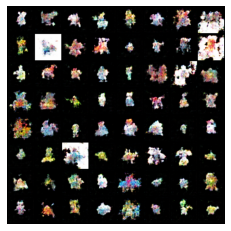

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [213/2000], loss_g: 3.0270, loss_d: 1.1072, real_score: 0.7885, fake_score: 0.4083
Saving generated-images-0213.png


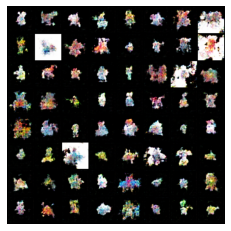

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [214/2000], loss_g: 4.3574, loss_d: 0.9699, real_score: 0.7623, fake_score: 0.3013
Saving generated-images-0214.png


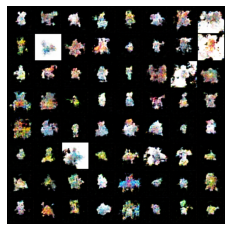

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [215/2000], loss_g: 4.3136, loss_d: 0.9650, real_score: 0.8150, fake_score: 0.2390
Saving generated-images-0215.png


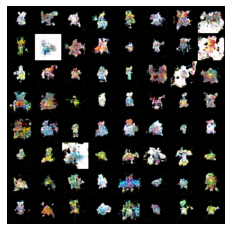

Saving:  model/generator/generator-0215.pth
Saving:  model/discriminator/discriminator-0215.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [216/2000], loss_g: 4.3177, loss_d: 0.9599, real_score: 0.7744, fake_score: 0.2671
Saving generated-images-0216.png


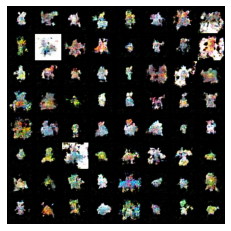

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [217/2000], loss_g: 2.6298, loss_d: 0.9748, real_score: 0.8330, fake_score: 0.2827
Saving generated-images-0217.png


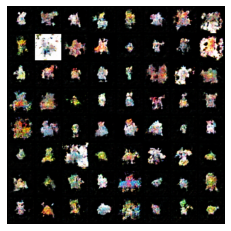

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [218/2000], loss_g: 6.6322, loss_d: 1.3406, real_score: 0.8375, fake_score: 0.6115
Saving generated-images-0218.png


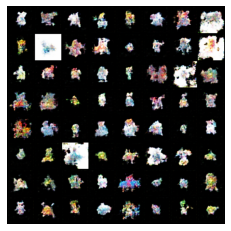

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [219/2000], loss_g: 7.9231, loss_d: 1.0557, real_score: 0.8390, fake_score: 0.2311
Saving generated-images-0219.png


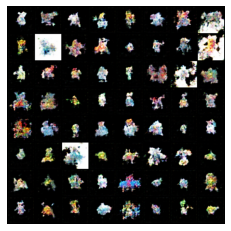

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [220/2000], loss_g: 5.0300, loss_d: 0.9499, real_score: 0.8086, fake_score: 0.3152
Saving generated-images-0220.png


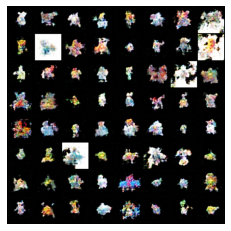

Saving:  model/generator/generator-0220.pth
Saving:  model/discriminator/discriminator-0220.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [221/2000], loss_g: 3.2664, loss_d: 1.1369, real_score: 0.6821, fake_score: 0.4202
Saving generated-images-0221.png


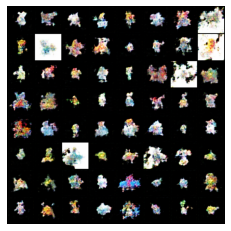

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [222/2000], loss_g: 5.4727, loss_d: 1.0917, real_score: 0.6978, fake_score: 0.2504
Saving generated-images-0222.png


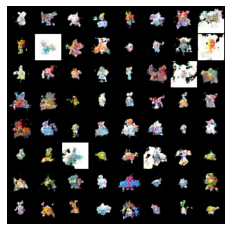

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [223/2000], loss_g: 5.4671, loss_d: 0.9951, real_score: 0.6799, fake_score: 0.2559
Saving generated-images-0223.png


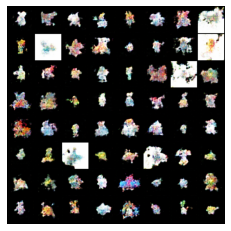

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [224/2000], loss_g: 7.0387, loss_d: 1.0006, real_score: 0.8330, fake_score: 0.3447
Saving generated-images-0224.png


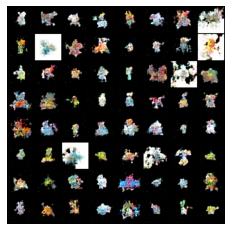

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [225/2000], loss_g: 5.6943, loss_d: 1.0242, real_score: 0.8385, fake_score: 0.3470
Saving generated-images-0225.png


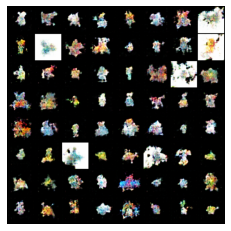

Saving:  model/generator/generator-0225.pth
Saving:  model/discriminator/discriminator-0225.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [226/2000], loss_g: 3.9077, loss_d: 1.0418, real_score: 0.7148, fake_score: 0.2649
Saving generated-images-0226.png


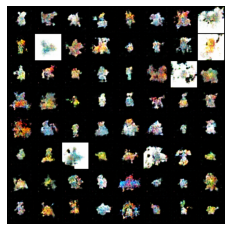

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [227/2000], loss_g: 5.1674, loss_d: 1.0104, real_score: 0.8356, fake_score: 0.2651
Saving generated-images-0227.png


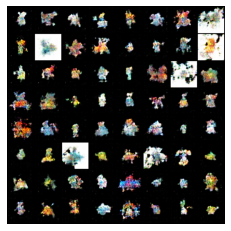

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [228/2000], loss_g: 4.9141, loss_d: 1.1117, real_score: 0.8021, fake_score: 0.4151
Saving generated-images-0228.png


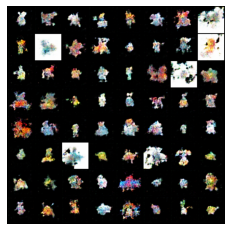

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [229/2000], loss_g: 7.4212, loss_d: 1.0979, real_score: 0.8260, fake_score: 0.2319
Saving generated-images-0229.png


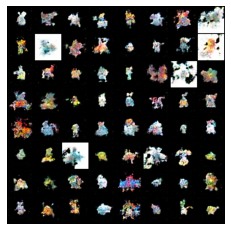

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [230/2000], loss_g: 2.8689, loss_d: 0.9775, real_score: 0.7659, fake_score: 0.2531
Saving generated-images-0230.png


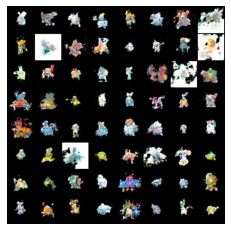

Saving:  model/generator/generator-0230.pth
Saving:  model/discriminator/discriminator-0230.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [231/2000], loss_g: 4.0760, loss_d: 0.9533, real_score: 0.7858, fake_score: 0.2296
Saving generated-images-0231.png


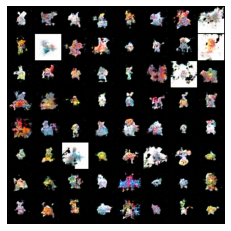

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [232/2000], loss_g: 4.9379, loss_d: 1.2102, real_score: 0.8025, fake_score: 0.5099
Saving generated-images-0232.png


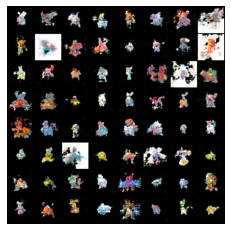

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [233/2000], loss_g: 4.7672, loss_d: 0.9219, real_score: 0.7222, fake_score: 0.2569
Saving generated-images-0233.png


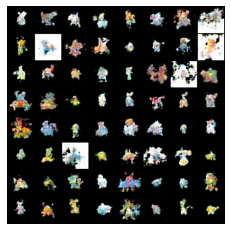

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [234/2000], loss_g: 4.5979, loss_d: 0.9819, real_score: 0.6869, fake_score: 0.2301
Saving generated-images-0234.png


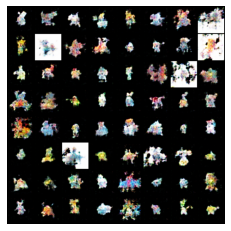

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [235/2000], loss_g: 6.6104, loss_d: 0.9903, real_score: 0.8216, fake_score: 0.2880
Saving generated-images-0235.png


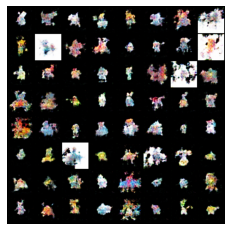

Saving:  model/generator/generator-0235.pth
Saving:  model/discriminator/discriminator-0235.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [236/2000], loss_g: 1.7739, loss_d: 0.9804, real_score: 0.7310, fake_score: 0.2497
Saving generated-images-0236.png


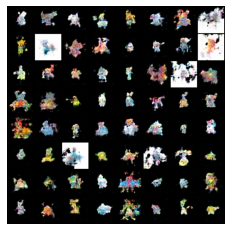

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [237/2000], loss_g: 4.8928, loss_d: 0.9794, real_score: 0.8243, fake_score: 0.2630
Saving generated-images-0237.png


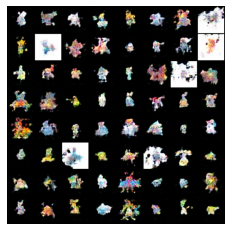

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [238/2000], loss_g: 5.6399, loss_d: 1.1018, real_score: 0.8266, fake_score: 0.4073
Saving generated-images-0238.png


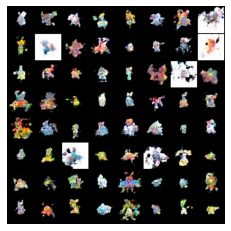

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [239/2000], loss_g: 6.6357, loss_d: 1.0001, real_score: 0.8324, fake_score: 0.2613
Saving generated-images-0239.png


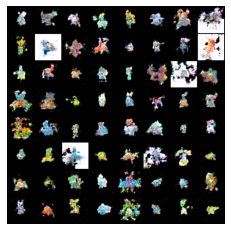

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [240/2000], loss_g: 4.6244, loss_d: 0.9596, real_score: 0.7990, fake_score: 0.2544
Saving generated-images-0240.png


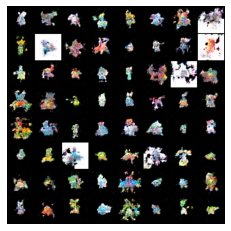

Saving:  model/generator/generator-0240.pth
Saving:  model/discriminator/discriminator-0240.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [241/2000], loss_g: 6.8198, loss_d: 0.9544, real_score: 0.8228, fake_score: 0.2817
Saving generated-images-0241.png


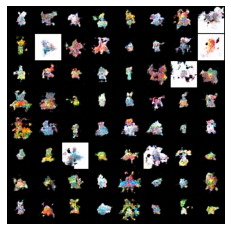

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [242/2000], loss_g: 4.2533, loss_d: 1.1365, real_score: 0.5670, fake_score: 0.2567
Saving generated-images-0242.png


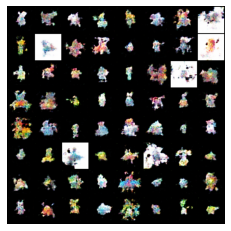

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [243/2000], loss_g: 4.8870, loss_d: 0.9767, real_score: 0.7606, fake_score: 0.2369
Saving generated-images-0243.png


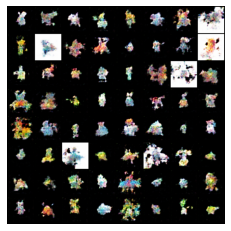

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [244/2000], loss_g: 6.1362, loss_d: 0.9530, real_score: 0.8131, fake_score: 0.2314
Saving generated-images-0244.png


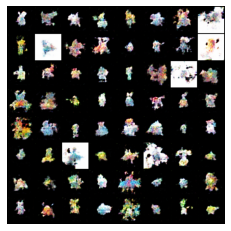

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [245/2000], loss_g: 6.0494, loss_d: 0.9680, real_score: 0.7842, fake_score: 0.2337
Saving generated-images-0245.png


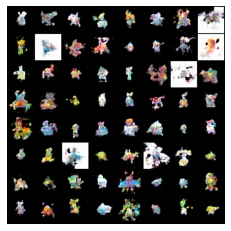

Saving:  model/generator/generator-0245.pth
Saving:  model/discriminator/discriminator-0245.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [246/2000], loss_g: 3.6296, loss_d: 1.0022, real_score: 0.8046, fake_score: 0.2770
Saving generated-images-0246.png


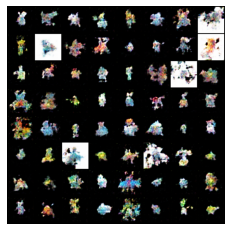

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [247/2000], loss_g: 6.0717, loss_d: 1.0013, real_score: 0.7823, fake_score: 0.2547
Saving generated-images-0247.png


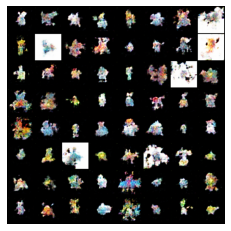

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [248/2000], loss_g: 6.7362, loss_d: 0.9847, real_score: 0.8116, fake_score: 0.2590
Saving generated-images-0248.png


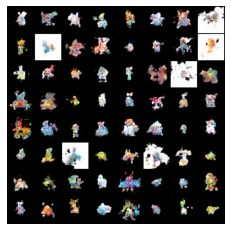

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [249/2000], loss_g: 4.6440, loss_d: 1.0340, real_score: 0.6289, fake_score: 0.2282
Saving generated-images-0249.png


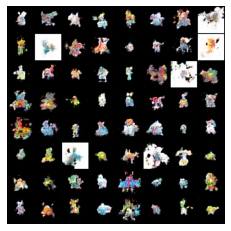

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [250/2000], loss_g: 6.6835, loss_d: 0.9049, real_score: 0.7908, fake_score: 0.2511
Saving generated-images-0250.png


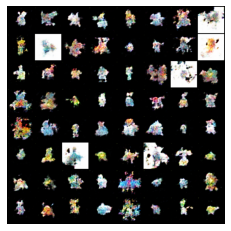

Saving:  model/generator/generator-0250.pth
Saving:  model/discriminator/discriminator-0250.pth


  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [251/2000], loss_g: 5.5432, loss_d: 0.9885, real_score: 0.7439, fake_score: 0.2721
Saving generated-images-0251.png


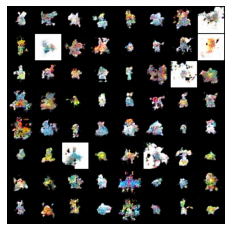

  0%|          | 0/13 [00:00<?, ?it/s]

Epoch [252/2000], loss_g: 5.7281, loss_d: 0.9831, real_score: 0.7602, fake_score: 0.2927
Saving generated-images-0252.png


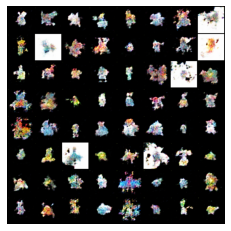

  0%|          | 0/13 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [119]:
lr = .0002
epochs = 2000
history = fit(epochs, lr)

In [ ]:
losses_g, losses_d, real_scores, fake_scores = history

from IPython.display import Image

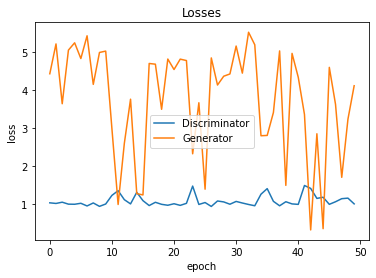

In [ ]:
plt.plot(losses_d, '-')
plt.plot(losses_g, '-')
plt.xlabel('epoch')
plt.ylabel('loss')
plt.legend(['Discriminator', 'Generator'])
plt.title('Losses');

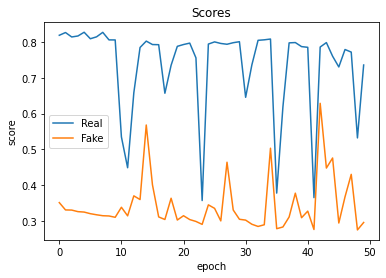

In [ ]:
plt.plot(real_scores, '-')
plt.plot(fake_scores, '-')
plt.xlabel('epoch')
plt.ylabel('score')
plt.legend(['Real', 'Fake'])
plt.title('Scores');